In [9]:
import torch
import intel_extension_for_pytorch as ipex
import matplotlib
import matplotlib.pyplot as plt
import numpy
import cv2
import numpy as np
import torch.nn.functional as F

In [10]:
a = []
for i in range(31):
    temp = torch.load(f'temp/attn-block-{i}.pt')
    a.append(temp)

In [3]:
for t in a:
    print(t.shape)

torch.Size([400, 196, 196])
torch.Size([400, 196, 196])
torch.Size([400, 196, 196])
torch.Size([400, 196, 196])
torch.Size([400, 196, 196])
torch.Size([400, 196, 196])
torch.Size([400, 196, 196])
torch.Size([16, 4096, 4096])
torch.Size([400, 196, 196])
torch.Size([400, 196, 196])
torch.Size([400, 196, 196])
torch.Size([400, 196, 196])
torch.Size([400, 196, 196])
torch.Size([400, 196, 196])
torch.Size([400, 196, 196])
torch.Size([16, 4096, 4096])
torch.Size([400, 196, 196])
torch.Size([400, 196, 196])
torch.Size([400, 196, 196])
torch.Size([400, 196, 196])
torch.Size([400, 196, 196])
torch.Size([400, 196, 196])
torch.Size([400, 196, 196])
torch.Size([16, 4096, 4096])
torch.Size([400, 196, 196])
torch.Size([400, 196, 196])
torch.Size([400, 196, 196])
torch.Size([400, 196, 196])
torch.Size([400, 196, 196])
torch.Size([400, 196, 196])
torch.Size([400, 196, 196])


In [11]:


def visualize_attn(attn, h=4, w=4, figsize=(32, 32), cmap='Greys'):
    fig, ax = plt.subplots(h, w, figsize=figsize)

    for i in range(h):
        for j in range(w):
            ax[i, j].imshow(attn[i * w + j], cmap=cmap)
    return fig, ax

def visualize_windowed_attn(attn, figsize=(32, 32)):
    windows = 25
    t = torch.zeros((16, 4900, 4900))
    temp = attn.reshape(16, 25, 196, 196)
    for i in range(windows):
        t[:, i*196:i*196+196, i*196:i*196+196] = temp[:, i, :, :]
    t_final = t[:, :4096, :4096]
    return visualize_attn(t_final)

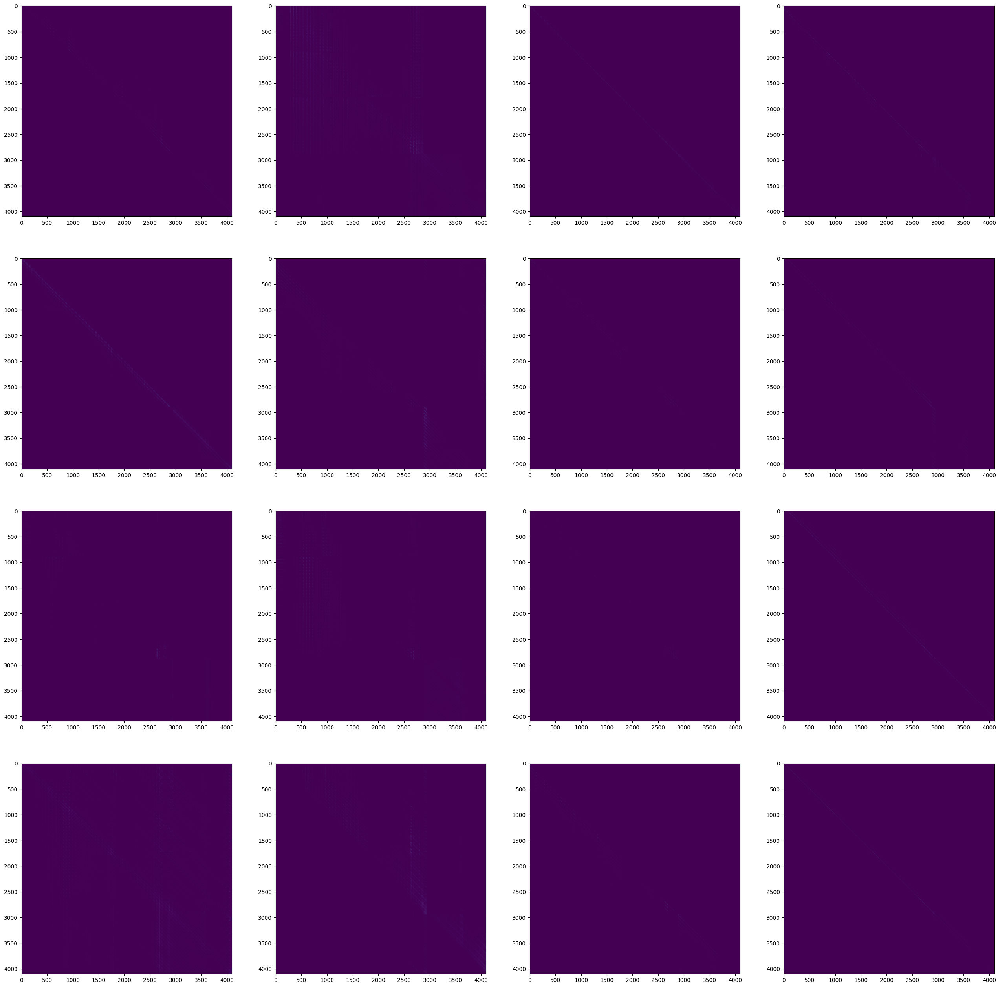

In [12]:
visualize_attn(a[15].cpu(), cmap='viridis')
plt.savefig('attn-15.png')

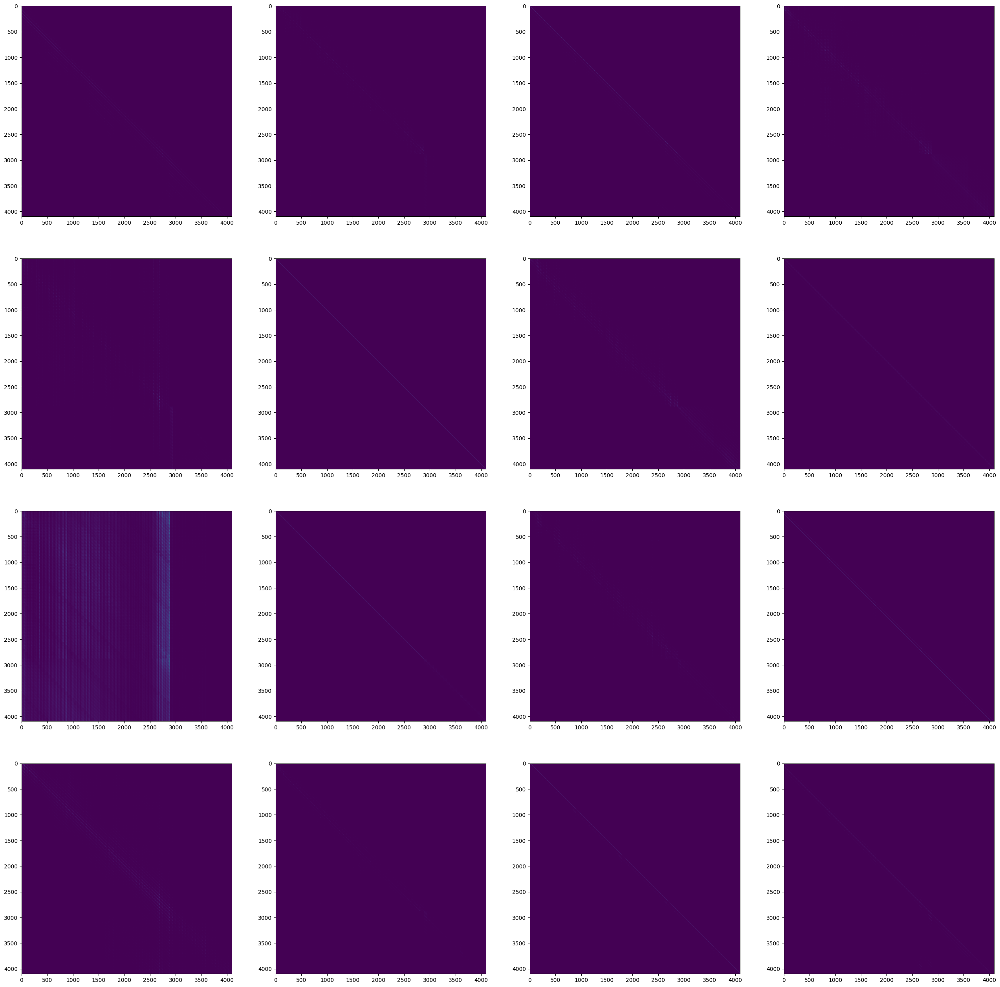

In [13]:
visualize_attn(a[7].cpu(), cmap='viridis')
plt.savefig('attn-7.png')

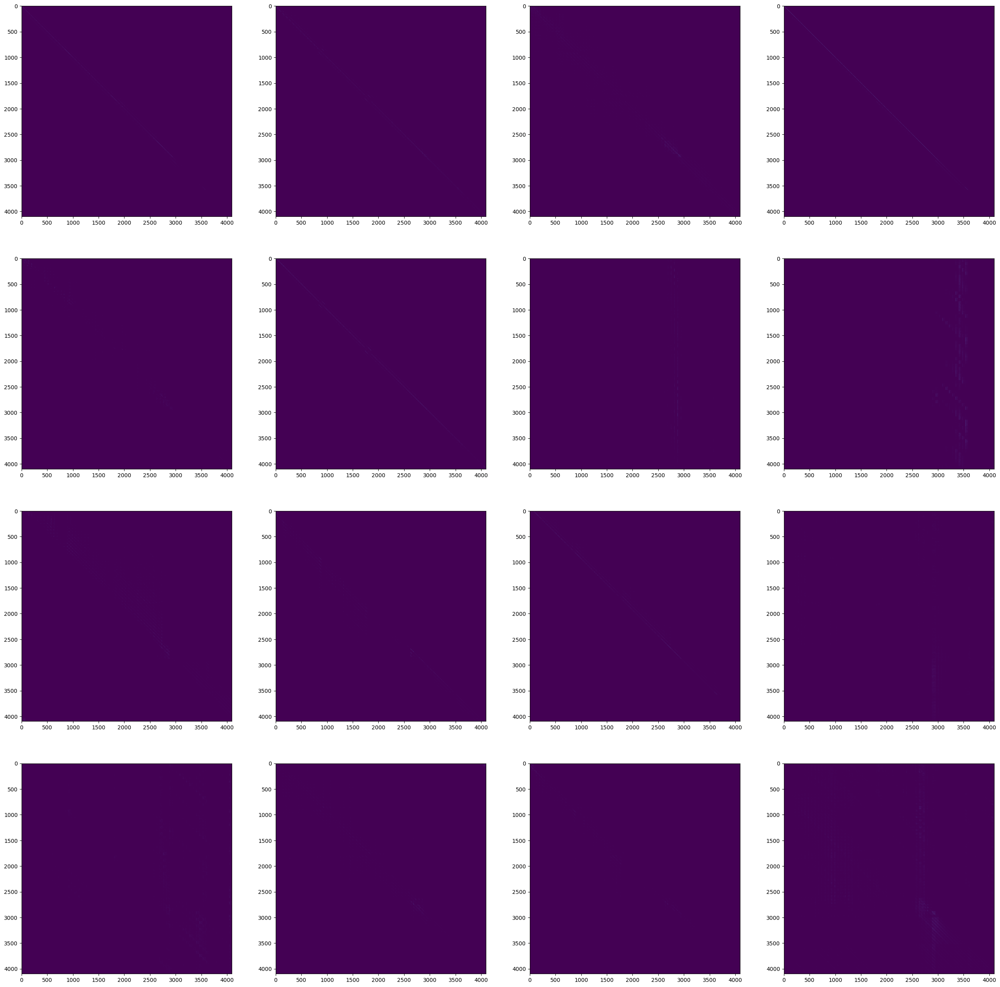

In [14]:
visualize_attn(a[23].cpu(), cmap='viridis')
plt.savefig('attn-23.png')

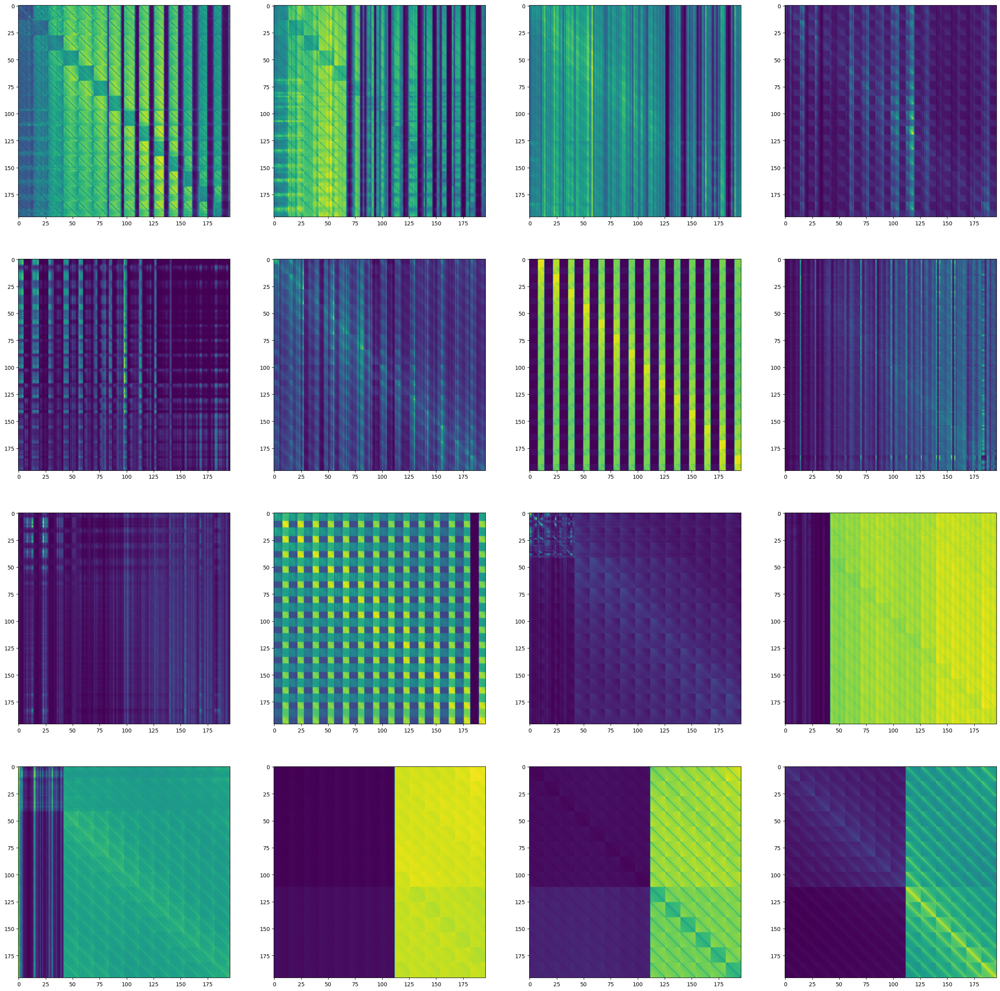

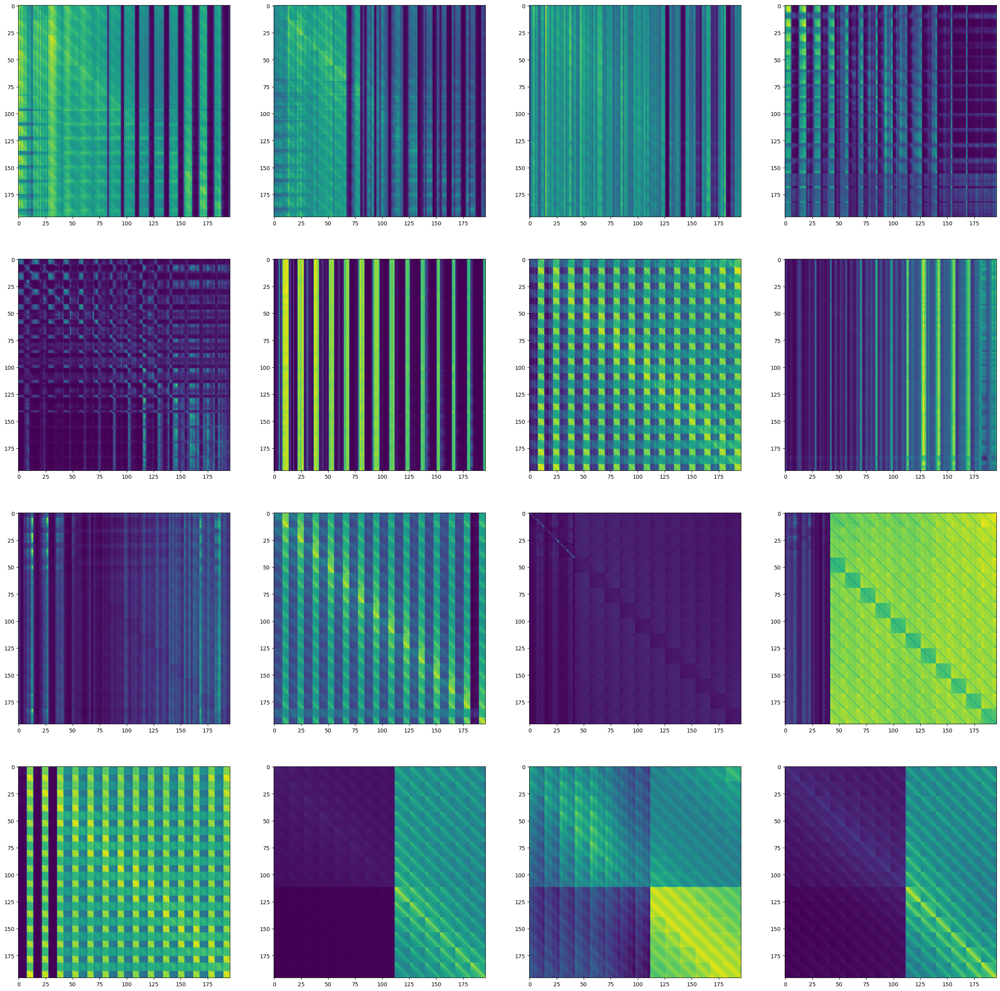

In [15]:
t = a[0].reshape(16, 25, 196, 196).transpose(0, 1)
visualize_attn(t[0].cpu(), cmap='viridis')
plt.savefig('attn-0-window-1.png')

t = a[0].reshape(16, 25, 196, 196).transpose(0, 1)
visualize_attn(t[6].cpu(), cmap='viridis')
plt.savefig('attn-0-window-6.png')

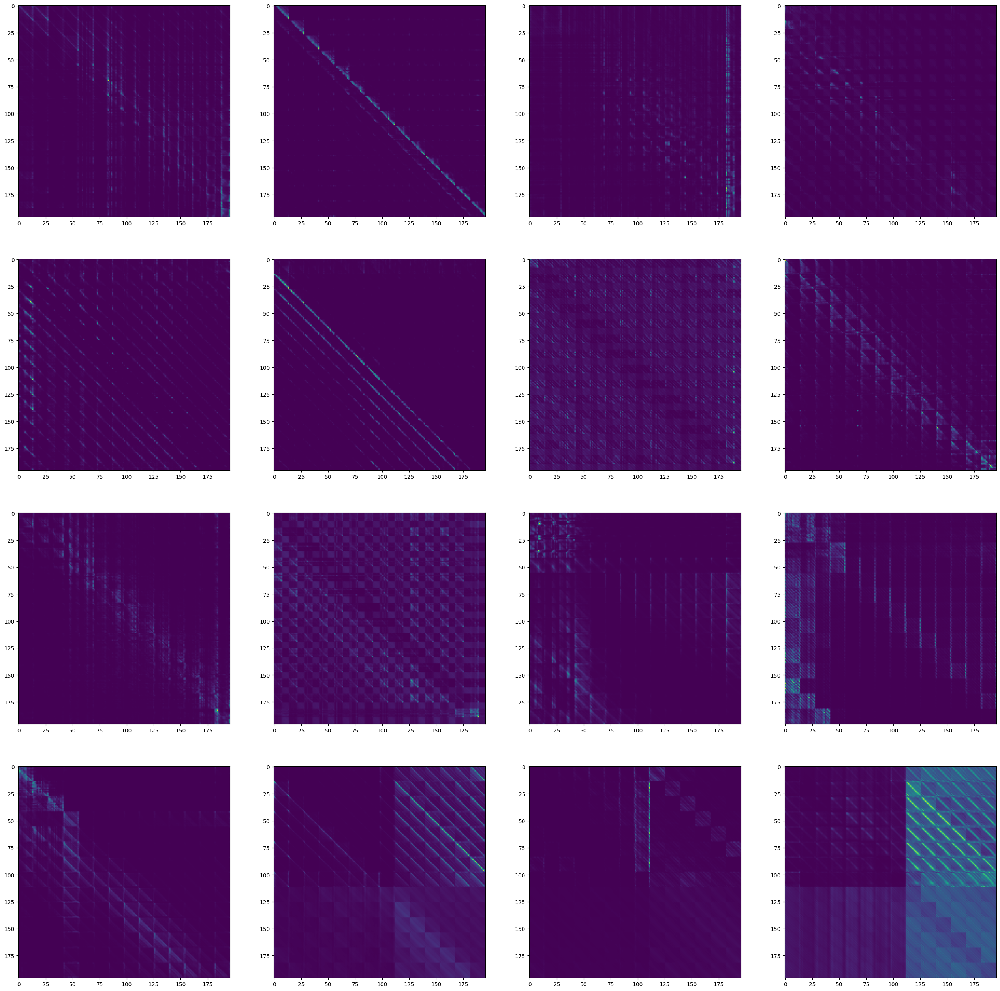

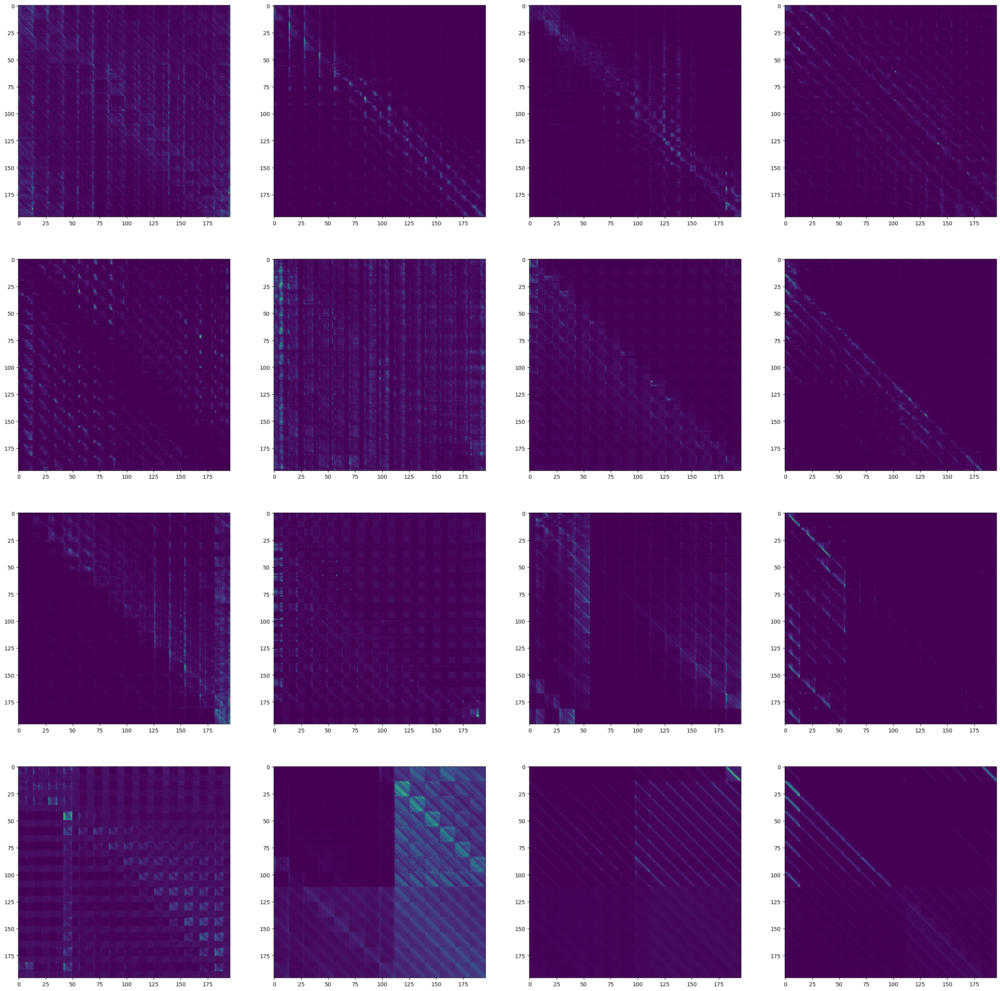

In [16]:
t = a[22].reshape(16, 25, 196, 196).transpose(0, 1)
visualize_attn(t[0].cpu(), cmap='viridis')
plt.savefig('attn-22-window-1.png')

t = a[22].reshape(16, 25, 196, 196).transpose(0, 1)
visualize_attn(t[6].cpu(), cmap='viridis')
plt.savefig('attn-22-window-6.png')

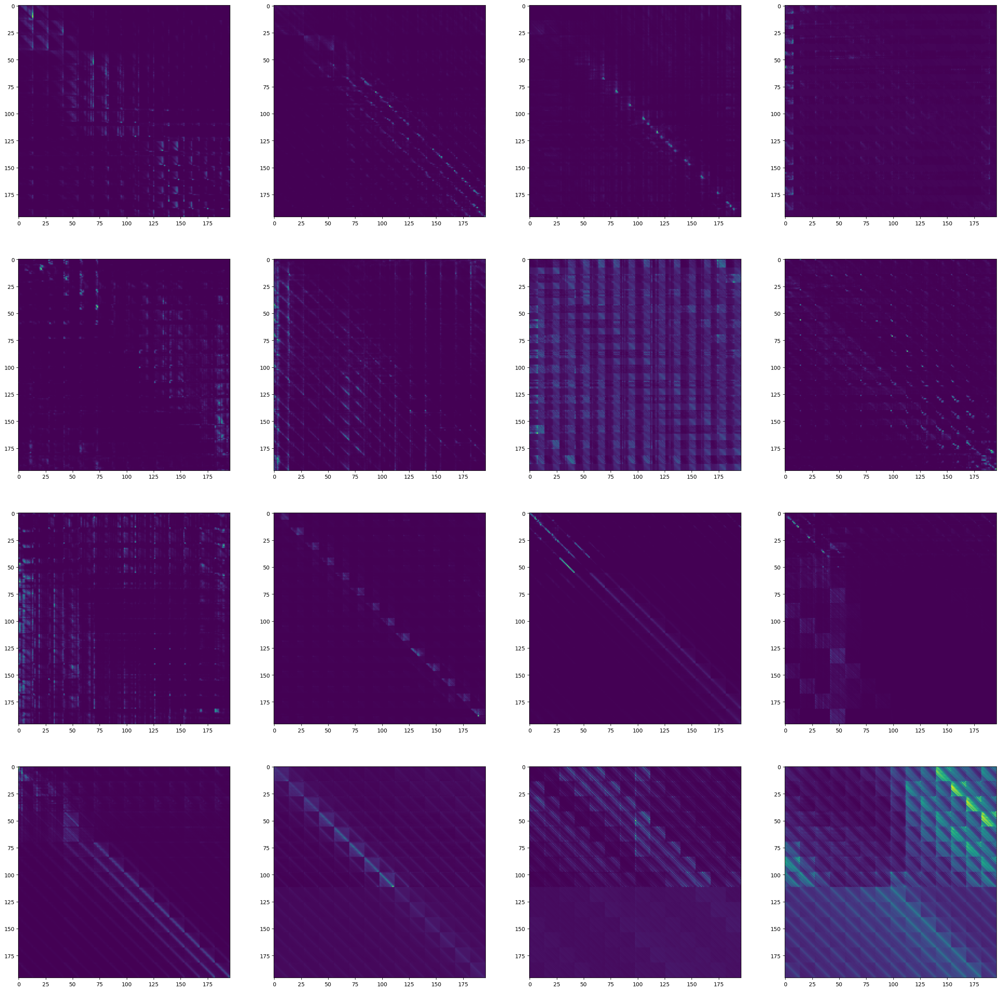

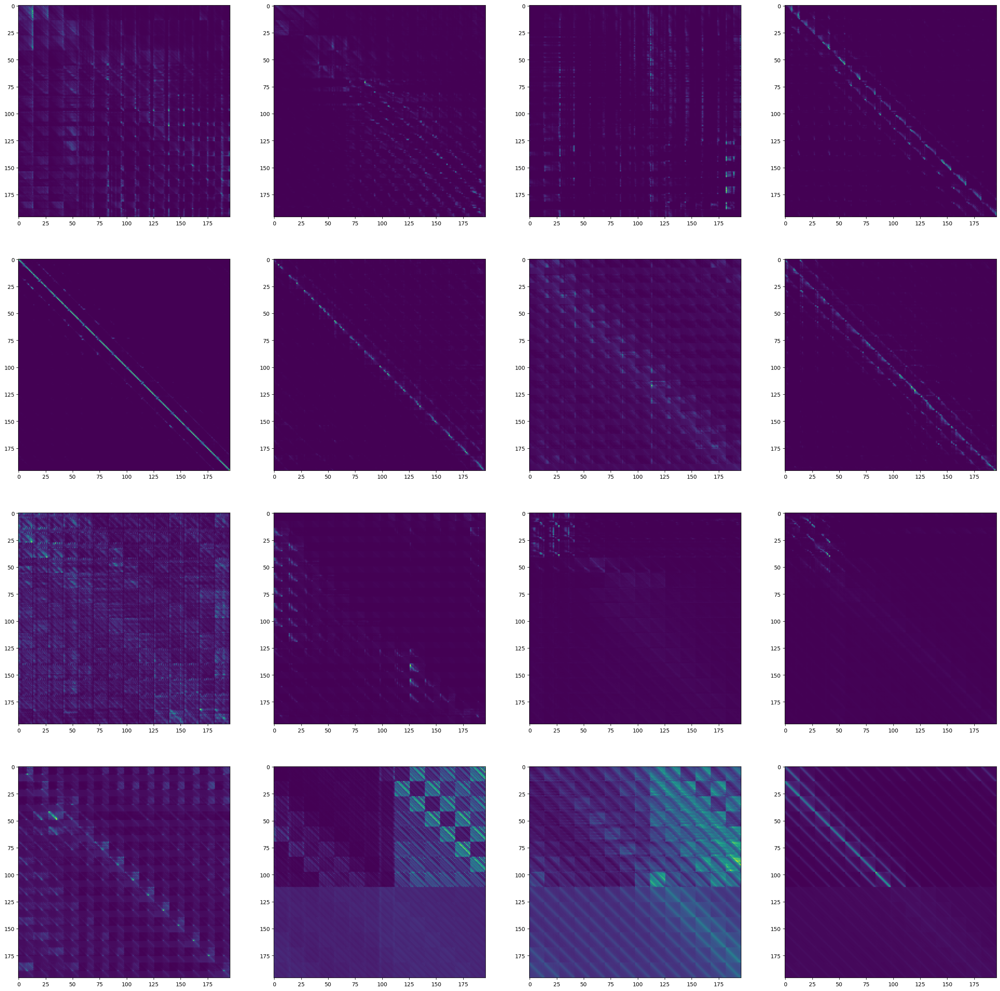

In [17]:
t = a[30].reshape(16, 25, 196, 196).transpose(0, 1)
visualize_attn(t[0].cpu(), cmap='viridis')
plt.savefig('attn-30-window-1.png')

t = a[30].reshape(16, 25, 196, 196).transpose(0, 1)
visualize_attn(t[6].cpu(), cmap='viridis')
plt.savefig('attn-30-window-6.png')

In [18]:
def get_attn_heatmap(attn, token, h=64):
    t = attn[token, :]
    t = t.reshape((h, h))
    return t

(1024, 1024, 3)


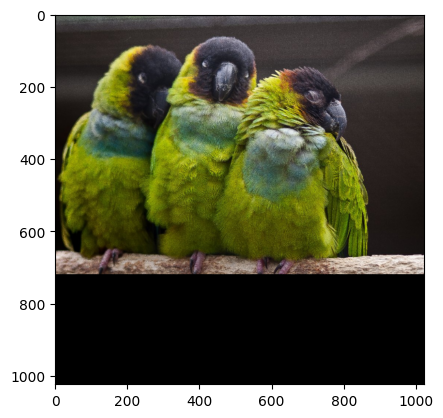

In [21]:
image_torch = torch.load('image.pt')
image_torch = F.pad(image_torch.permute(2, 0, 1), (0, 0, 0, 1024 - image_torch.shape[0])).permute(1, 2, 0).cpu().numpy()
image_torch.shape
plt.imshow(image_torch)
print(image_torch.shape)

2024-10-23 23:06:36,608 - matplotlib.image - WARNING - Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..2.8644018509808706].


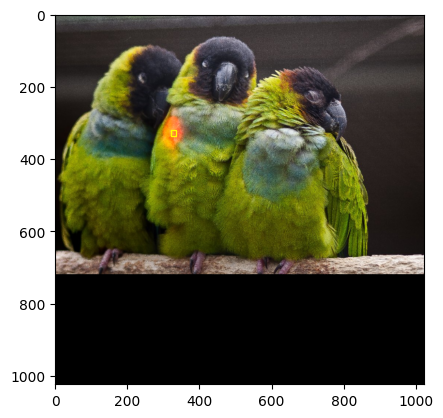

In [22]:
t_i, t_j = 20, 20
hm = get_attn_heatmap(a[23].cpu()[0], 64 * t_i + t_j)
hm2 = cv2.resize(hm.numpy(), (1024, 1024))
temp = image_torch[:, :, :] / 255.0
temp[:, :, 0] += 20 * hm2
plt.imshow(temp)
rectangle = plt.Rectangle((16 * t_i, 16 * t_j), 16, 16, edgecolor='yellow', fill=False, linewidth=1)
plt.gca().add_artist(rectangle)

In [29]:
def visualize_attn_heatmap(attn, token, layer):
    fig, ax = plt.subplots(4, 4, figsize=(32, 32))
    t_i, t_j = token[0], token[1]
    for i in range(4):
        for j in range(4):
            hm = get_attn_heatmap(attn[i * 4 + j], 64 * t_i + t_j)
            hm2 = cv2.resize(hm.numpy(), (1024, 1024))
            temp = image_torch[:, :, :] / 255.0 / 2
            temp[:, :, 0] += 20 * hm2
            ax[i, j].imshow(np.clip(temp, 0, 1))

            rectangle = plt.Rectangle((16 * t_j, 16 * t_i), 16, 16, edgecolor='yellow', fill=False, linewidth=1)  # 左下角(30, 30)，宽40，高20
            ax[i, j].add_artist(rectangle)

    plt.show()
    fig.savefig(f'attn-{layer}-heatmap-{token}.png')
    return fig, ax

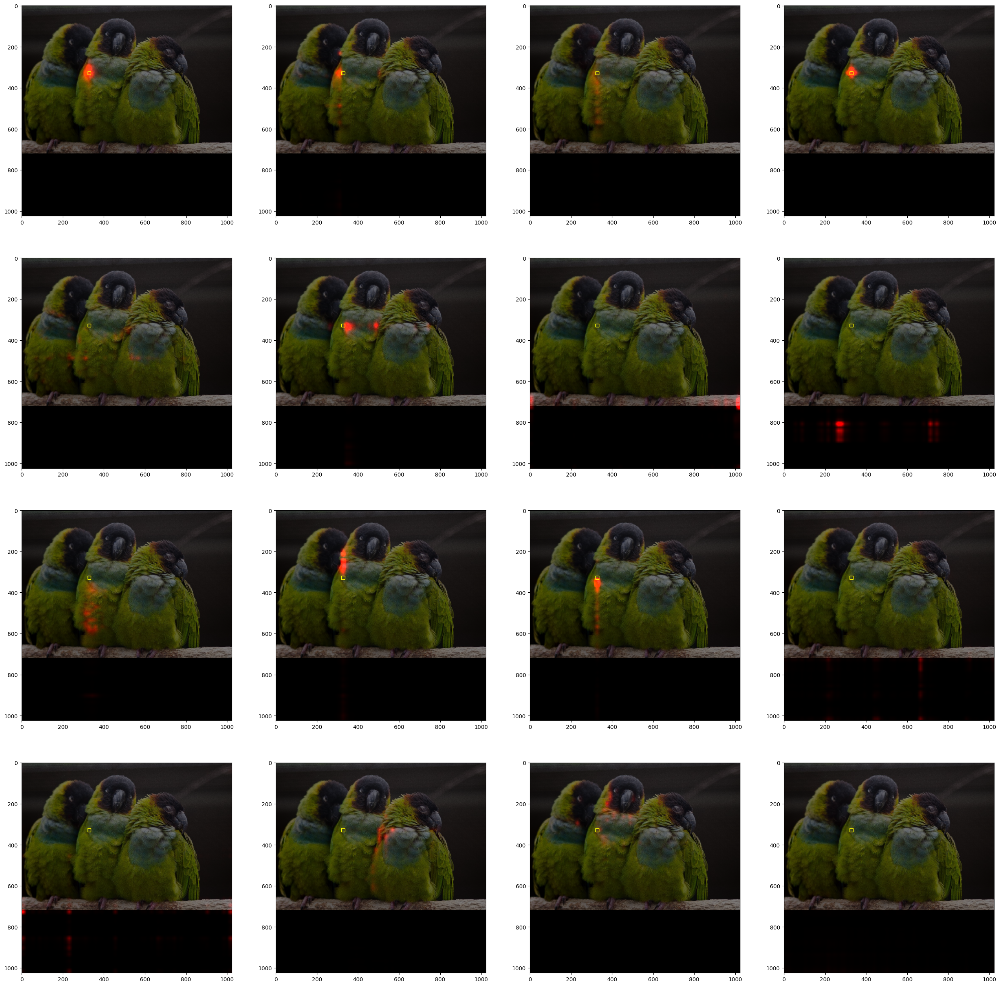

(<Figure size 3200x3200 with 16 Axes>,
 array([[<Axes: >, <Axes: >, <Axes: >, <Axes: >],
        [<Axes: >, <Axes: >, <Axes: >, <Axes: >],
        [<Axes: >, <Axes: >, <Axes: >, <Axes: >],
        [<Axes: >, <Axes: >, <Axes: >, <Axes: >]], dtype=object))

In [30]:
visualize_attn_heatmap(a[23].cpu(), (20, 20), 23)

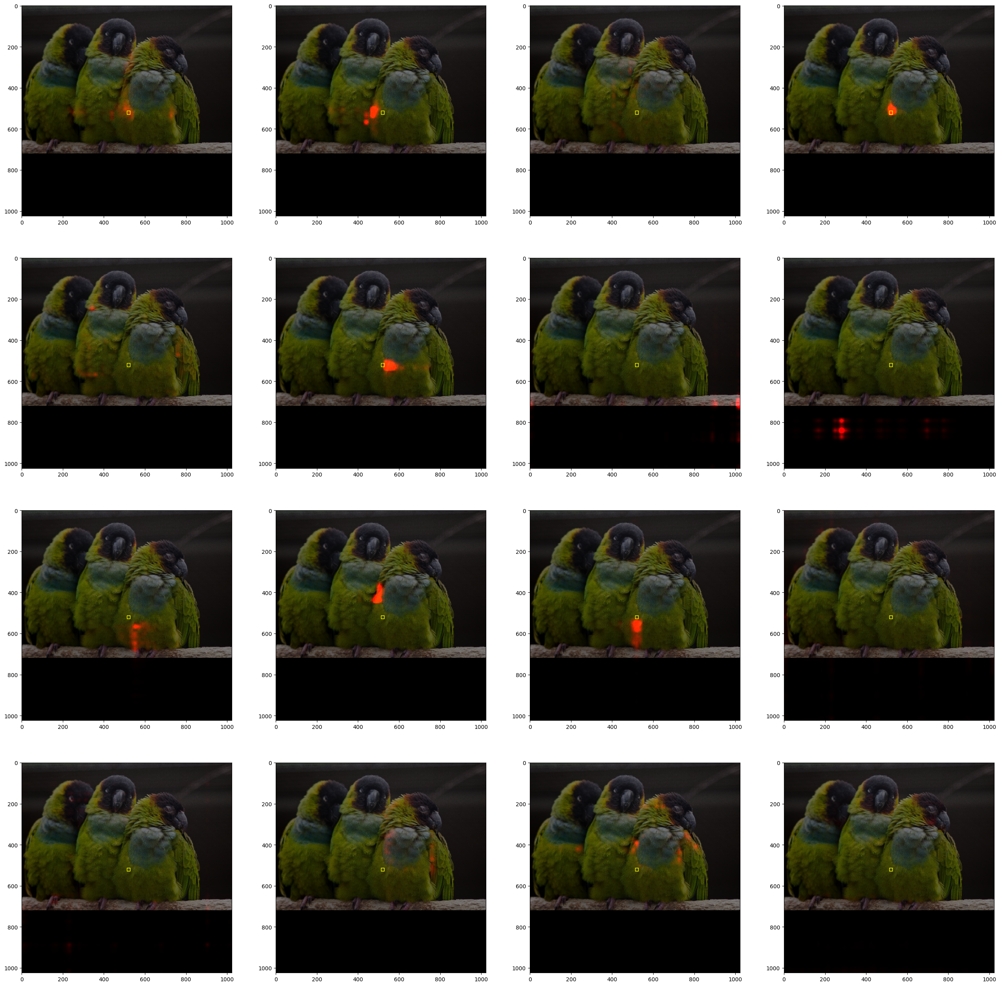

(<Figure size 3200x3200 with 16 Axes>,
 array([[<Axes: >, <Axes: >, <Axes: >, <Axes: >],
        [<Axes: >, <Axes: >, <Axes: >, <Axes: >],
        [<Axes: >, <Axes: >, <Axes: >, <Axes: >],
        [<Axes: >, <Axes: >, <Axes: >, <Axes: >]], dtype=object))

In [35]:
visualize_attn_heatmap(a[23].cpu(), (32, 32), 23)

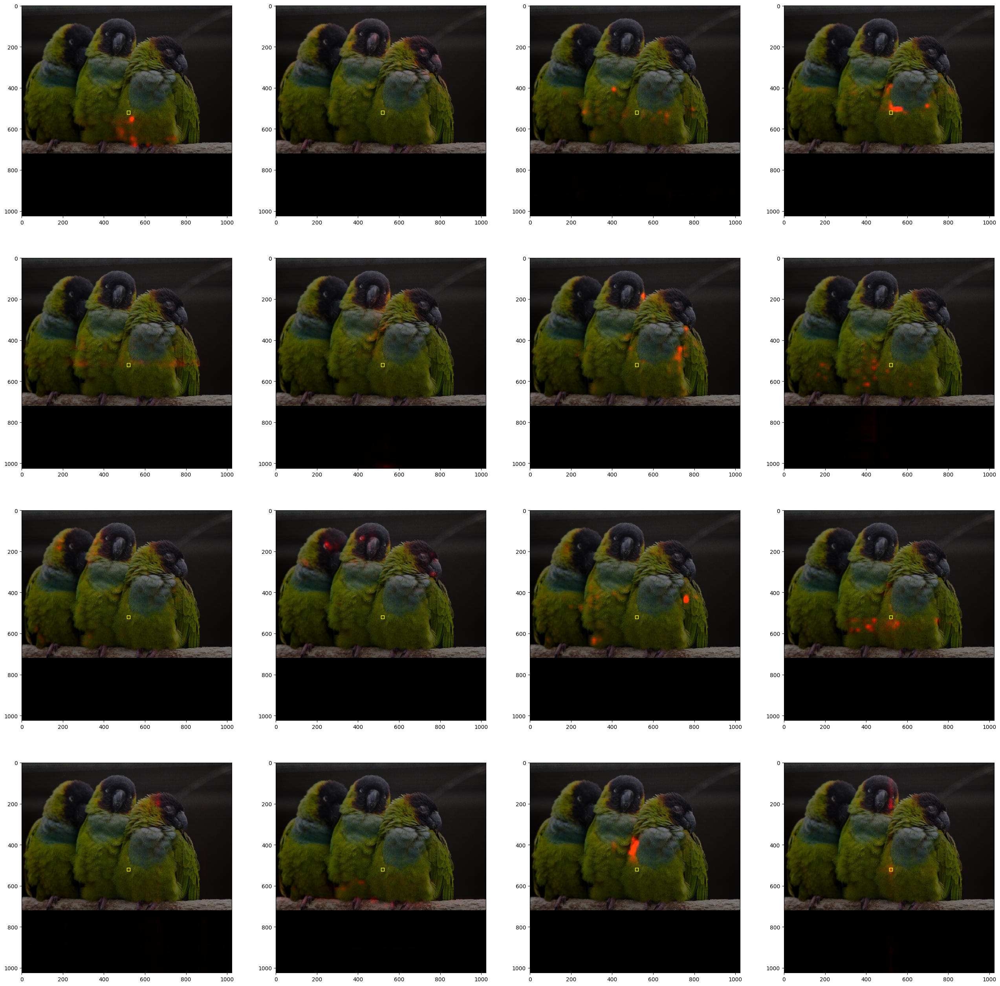

(<Figure size 3200x3200 with 16 Axes>,
 array([[<Axes: >, <Axes: >, <Axes: >, <Axes: >],
        [<Axes: >, <Axes: >, <Axes: >, <Axes: >],
        [<Axes: >, <Axes: >, <Axes: >, <Axes: >],
        [<Axes: >, <Axes: >, <Axes: >, <Axes: >]], dtype=object))

In [34]:
visualize_attn_heatmap(a[15].cpu(), (32, 32), 15)

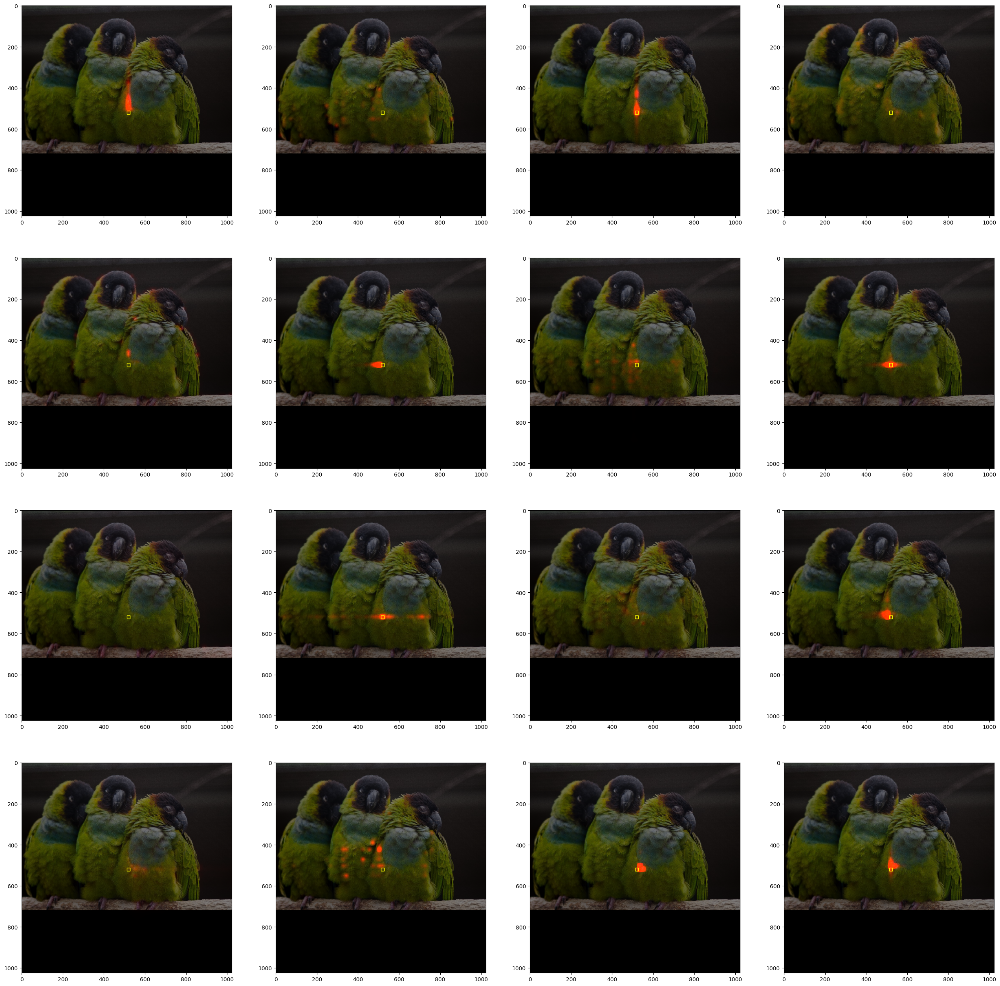

(<Figure size 3200x3200 with 16 Axes>,
 array([[<Axes: >, <Axes: >, <Axes: >, <Axes: >],
        [<Axes: >, <Axes: >, <Axes: >, <Axes: >],
        [<Axes: >, <Axes: >, <Axes: >, <Axes: >],
        [<Axes: >, <Axes: >, <Axes: >, <Axes: >]], dtype=object))

In [33]:
visualize_attn_heatmap(a[7].cpu(), (32, 32), 7)